# **Poker Data Project**

>[Poker Data Project](#scrollTo=0Kx2BlCehXFU)

>[Introduction](#scrollTo=WhPRLSuHOz75)

>[Data Collection and Cleaning](#scrollTo=2NXMWTeohcE0)

>[Initial import from github and minor cleaning](#scrollTo=AeIzIv_feqjg)

>[Start Table](#scrollTo=XhqFMrlmV4oU)

>[Summary Table](#scrollTo=ehsruyHGWKO6)

>[Action Table](#scrollTo=9UpG9jl7ZVTA)

>[Creating the Long-Joined Data Frame](#scrollTo=1vbHM9JGV_b-)

>[Importing Data For Exploration](#scrollTo=qZp-raEsVd1z)

>[Analysis](#scrollTo=2Yoie_h_Jp3S)

>[Analyzing the effectivenss of preflop raise sizing](#scrollTo=n2gR9HQgw7Ja)

>[Building a model to predict net change in player stack amount](#scrollTo=D1GBceTuxMrc)

>[Building a model to predict whether a player wins a hand](#scrollTo=rM8OL_KSAkPU)



**Source:** http://web.archive.org/web/20110205042259/http://www.outflopped.com/questions/286/obfuscated-datamined-hand-histories

*Data Files:* http://static.handhq.com/hands/obfuscated/ABS-2009-07-01_2009-07-23_1000NLH_OBFU.zip

# Introduction

The data I found contains the game log of thousands of hands from online amateur poker games of different styles. Over the summer for fun, I initially cleaned some of the data in R as I was wanting to learn more about the game through real world data exploration. In this initial cleaning process, I was able to only include data from games which were 6 handed, had no antes, and posted a \$5 big blind and \$10 small blind. I was also able to get this data into a tabular form which it was initially not in, however, I became sidetracked once school started again and never finished my mission. After this project was assigned, I thought it would be the perfect opportunity to continue my mission. I was able to convert some of my tables in R to csv files which I then uploaded to github and then pandas where we continued the data cleaning process.

We were particularly interested in 6-handed games as that is around the average number of players that usually participate when I play. The csv files imported from github contain information on 13,954 unique 6-handed games. Below, we initially created 3 data frames, each containing information at different phases of the hand. In all 3 data frames, each observation represents one hand and has a unique 10 digit ID allowing for easy merges. The player names within the data are encoded as random sequences of letters and numbers in order to keep the players anonymous.

From there, we then created one larger data frame containing information from the initial 3 data frames. This new data frame is larger not only in width, but it is also 6 times longer as each oservation contains information for a specific player within a game. Below is our entire data cleaning process.

For our data exploration and machine learning, we were interested in exploring 3 main questions. First, we wanted to see the significace of different raise sizes prior to the flop. Next, our primary question was to see if we could predict the net change in the amount of money in a player's stack during a hand based on their moves and other variables non-related to the cards at play. Finally, more simply we wanted to see whether we could predict whether a player would win a hand or not based on the same predictors as the above question.

In [ ]:
import pandas as pd
import numpy as np
import re
import altair as alt
from sklearn.preprocessing import StandardScaler, Normalizer, MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor, KNeighborsClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_val_score, GridSearchCV
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer
from sklearn.metrics import accuracy_score, precision_score, recall_score, mean_squared_error, mean_squared_error
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import euclidean_distances, cosine_similarity, cosine_distances
from sklearn.ensemble import VotingRegressor

# **Data Collection and Cleaning**

# Initial import from github and minor cleaning

In [ ]:
# importing and cleaning original tables from github
main = pd.read_csv('https://raw.githubusercontent.com/joshblank73/DATA-301/main/poker_data301.csv')
main = main.iloc[:, 1:]

start = pd.read_csv('https://raw.githubusercontent.com/joshblank73/DATA-301/main/poker_start_data301.csv')
start = start.iloc[:, 1:]

summary = pd.read_csv('https://raw.githubusercontent.com/joshblank73/DATA-301/main/poker_summary_data301.csv')
summary = summary.iloc[:, 1:]

action_count = pd.read_csv('https://raw.githubusercontent.com/joshblank73/DATA-301/main/poker_action_data301.csv')
action_count = action_count.iloc[:, 1:]

action = pd.DataFrame(main.iloc[:, 0])
new = main['action'].str.split('\*\*\* FLOP \*\*\*', expand = True)
action['pocket'] = new[0]
action['pocket'] = action['pocket'].str.split('\r\n')
action['flop'] = new[1]
new = action['flop'].str.split('\*\*\* TURN \*\*\*', expand = True)
action['flop'] = new[0]
action['flop'] = action['flop'].str.split('\r\n')
action['turn'] = new[1]
new = action['turn'].str.split('\*\*\* RIVER \*\*\*', expand = True)
action['turn'] = new[0]
action['river'] = new[1]
action['turn'] = action['turn'].str.split('\r\n')
action['river'] = action['river'].str.split('\r\n')

for i in range(len(action)):
  action['pocket'][i] = action['pocket'][i][:-1]

  if action['flop'][i] != None:
    action['flop'][i] = action['flop'][i][1:-1]
  else:
    action['flop'][i] = []

  if action['turn'][i] != None:
    action['turn'][i] = action['turn'][i][1:-1]
  else:
    action['turn'][i] = []
  
  if action['river'][i] != None:
    action['river'][i] = action['river'][i][1:-1]
  else:
    action['river'][i] = []

action = action.merge(action_count, on='id')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: SettingWithCopyWarning: 
A value is trying to b

# Start Table

The first data frame is called "start" since it contains information on each hand before the hand is played. This includes the hand ID, the table name, the name of the player at each position of the table, and the stack sizes (amount of money the player at each position has) before the hand gets played. The 6 positions are sb (small blind), bb (big blind), utg (under the gun), p4 (player 4), p5 (player 5), and d (dealer). I have placed them in this order as this is the order in which they play during the game with the small blind acting first and the dealer acting last.

In [ ]:
start.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13954 entries, 0 to 13953
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   id         13954 non-null  int64  
 1   table      13954 non-null  object 
 2   sb         13954 non-null  object 
 3   sb_stack   13954 non-null  float64
 4   bb         13954 non-null  object 
 5   bb_stack   13954 non-null  float64
 6   utg        13954 non-null  object 
 7   utg_stack  13954 non-null  float64
 8   p4         13954 non-null  object 
 9   p4_stack   13954 non-null  float64
 10  p5         13954 non-null  object 
 11  p5_stack   13954 non-null  float64
 12  d          13954 non-null  object 
 13  d_stack    13954 non-null  float64
dtypes: float64(6), int64(1), object(7)
memory usage: 1.5+ MB


In [ ]:
start.head()

,id,table,sb,sb_stack,bb,bb_stack,utg,utg_stack,p4,p4_stack,p5,p5_stack,d,d_stack
0,3017263190,NAURU HWY,yOOMTqsR9EFECI4lSNpp1A,1944.50,Ga4nLjbXWOp+RvIPu1VksQ,603.00,4QICpZ6v7I+i8nJKeSSE8Q,4066.50,c2tiA/SMUK+T0PsP2rCOGA,2024.75,X+u4T/E5ANkyZLKm1YjqwQ,3579.74,MiMarMfTeMU39pt2obBh3A,4179.75
1,3017265406,NAURU HWY,Ga4nLjbXWOp+RvIPu1VksQ,593.00,4QICpZ6v7I+i8nJKeSSE8Q,4066.50,c2tiA/SMUK+T0PsP2rCOGA,2024.75,X+u4T/E5ANkyZLKm1YjqwQ,3579.74,MiMarMfTeMU39pt2obBh3A,4216.25,yOOMTqsR9EFECI4lSNpp1A,2000.00
2,3017270592,NAURU HWY,4QICpZ6v7I+i8nJKeSSE8Q,4668.00,c2tiA/SMUK+T0PsP2rCOGA,1434.75,X+u4T/E5ANkyZLKm1YjqwQ,3579.74,MiMarMfTeMU39pt2obBh3A,4206.25,yOOMTqsR9EFECI4lSNpp1A,2000.00,Ga4nLjbXWOp+RvIPu1VksQ,588.00
3,3017272212,NAURU HWY,c2tiA/SMUK+T0PsP2rCOGA,1424.75,X+u4T/E5ANkyZLKm1YjqwQ,3579.74,MiMarMfTeMU39pt2obBh3A,4224.25,yOOMTqsR9EFECI4lSNpp1A,2000.00,Ga4nLjbXWOp+RvIPu1VksQ,588.00,4QICpZ6v7I+i8nJKeSSE8Q,4658.00
4,3017277764,NAURU HWY,X+u4T/E5ANkyZLKm1YjqwQ,3439.74,MiMarMfTeMU39pt2obBh3A,4224.25,yOOMTqsR9EFECI4lSNpp1A,2000.00,Ga4nLjbXWOp+RvIPu1VksQ,588.00,4QICpZ6v7I+i8nJKeSSE8Q,4658.00,c2tiA/SMUK+T0PsP2rCOGA,2481.25


# Summary Table

The second data frame is called "summary" since it contains information on each hand after it is completed. This includes the hand ID, the pot size (amount of money collected by the winner(s)), the board (the community cards on the table), how each position finished the hand, the stage of the hand at which it ended, and the position of the winner of the hand.

In [ ]:
summary.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13954 entries, 0 to 13953
Data columns (total 11 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   id         13954 non-null  float64
 1   pot        13954 non-null  float64
 2   board      6616 non-null   object 
 3   sb         13951 non-null  object 
 4   bb         13793 non-null  object 
 5   utg        13948 non-null  object 
 6   p4         13954 non-null  object 
 7   p5         13941 non-null  object 
 8   d          13954 non-null  object 
 9   end_stage  13954 non-null  object 
 10  winner     13953 non-null  object 
dtypes: float64(2), object(9)
memory usage: 1.2+ MB


In [ ]:
summary.head()

,id,pot,board,sb,bb,utg,p4,p5,d,end_stage,winner
0,3.017263e+09,70.0,As 8h 9d Js,Folded on the TURN,Folded on the TURN,Folded on the POCKET CARDS,Folded on the POCKET CARDS,Folded on the POCKET CARDS,Won,turn,d
1,3.017265e+09,1195.0,3c Qh Kd Kh 2s,Folded on the POCKET CARDS,Won,Folded on the RIVER,Folded on the POCKET CARDS,Folded on the FLOP,Folded on the POCKET CARDS,river,bb
2,3.017271e+09,30.0,6d Qc Jc,Folded on the FLOP,Folded on the FLOP,Folded on the POCKET CARDS,Won,Folded on the POCKET CARDS,Folded on the POCKET CARDS,flop,p4
3,3.017272e+09,1980.0,2c 3c Jc 9c,Won,Folded on the FLOP,Folded on the POCKET CARDS,Folded on the TURN,Folded on the POCKET CARDS,Folded on the POCKET CARDS,turn,sb
4,3.017278e+09,425.0,As 6c 10h Qh 4s,Folded on the POCKET CARDS,Lost,Folded on the POCKET CARDS,Folded on the POCKET CARDS,Folded on the POCKET CARDS,Won,river,d


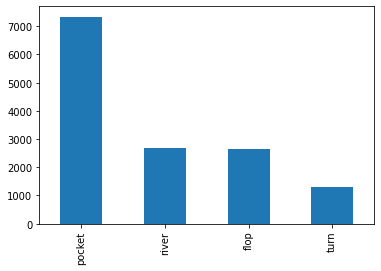

In [ ]:
summary['end_stage'].value_counts().plot.bar()

The above plot shows that most hands end before the flop and the least amount of hands end between the turn and the river.

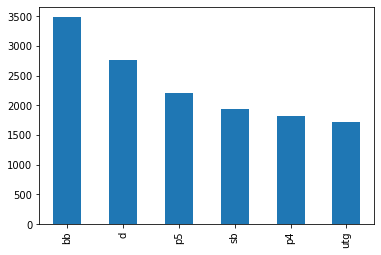

In [ ]:
summary['winner'].value_counts().plot.bar()

The above plot shows that the big blind is most likely to win a hand and that the player under the gun (first to act before the flop) is least likely to win.

# Action Table

The last data frame is called "action" as it describes what is occuring during the hand. This is the largest of the tables and again includes the hand ID variable. The pocket, flop, turn, and river variables all include lists that describe how the action progesses in order at each respective stage of the game. Each element in the list includes the player's name and what they did. If the list is empty, then that just means that no action occured since the hand ended before that stage was reached. The other varibles unclude a count of the number of each unique action type at each stage in the game. For example, if folds_pocket has a value of 3 then that means that 3 players folded at the pocket cards stage.

In [ ]:
action.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13954 entries, 0 to 13953
Data columns (total 25 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   id             13954 non-null  int64 
 1   pocket         13954 non-null  object
 2   flop           13954 non-null  object
 3   turn           13954 non-null  object
 4   river          13954 non-null  object
 5   folds_pocket   13954 non-null  int64 
 6   folds_flop     13954 non-null  int64 
 7   folds_turn     13954 non-null  int64 
 8   folds_river    13954 non-null  int64 
 9   checks_pocket  13954 non-null  int64 
 10  checks_flop    13954 non-null  int64 
 11  checks_turn    13954 non-null  int64 
 12  checks_river   13954 non-null  int64 
 13  calls_pocket   13954 non-null  int64 
 14  calls_flop     13954 non-null  int64 
 15  calls_turn     13954 non-null  int64 
 16  calls_river    13954 non-null  int64 
 17  bets_pocket    13954 non-null  int64 
 18  bets_flop      13954 non-n

In [ ]:
action.head()

,id,pocket,flop,turn,river,folds_pocket,folds_flop,folds_turn,folds_river,checks_pocket,...,calls_turn,calls_river,bets_pocket,bets_flop,bets_turn,bets_river,raises_pocket,raises_flop,raises_turn,raises_river
0,3017263190,"[4QICpZ6v7I+i8nJKeSSE8Q - Folds, c2tiA/SMUK+T0...","[yOOMTqsR9EFECI4lSNpp1A - Checks, Ga4nLjbXWOp+...","[yOOMTqsR9EFECI4lSNpp1A - Bets $20, Ga4nLjbXWO...",[],3,0,2,0,1,...,0,0,0,0,1,0,0,0,1,0
1,3017265406,"[c2tiA/SMUK+T0PsP2rCOGA - Calls $10, X+u4T/E5A...","[4QICpZ6v7I+i8nJKeSSE8Q - Bets $30, c2tiA/SMUK...","[4QICpZ6v7I+i8nJKeSSE8Q - Bets $60, c2tiA/SMUK...","[4QICpZ6v7I+i8nJKeSSE8Q - Checks, c2tiA/SMUK+T...",3,1,0,0,1,...,1,1,0,1,1,1,0,0,0,1
2,3017270592,"[X+u4T/E5ANkyZLKm1YjqwQ - Folds, MiMarMfTeMU39...","[4QICpZ6v7I+i8nJKeSSE8Q - Checks, c2tiA/SMUK+T...",[],[],3,2,0,0,1,...,0,0,0,1,0,0,0,0,0,0
3,3017272212,"[MiMarMfTeMU39pt2obBh3A - Folds, yOOMTqsR9EFEC...","[c2tiA/SMUK+T0PsP2rCOGA - Checks, X+u4T/E5ANky...","[c2tiA/SMUK+T0PsP2rCOGA - Checks, yOOMTqsR9EFE...",[],3,1,1,0,0,...,0,0,0,1,1,0,2,0,0,0
4,3017277764,"[yOOMTqsR9EFECI4lSNpp1A - Folds, Ga4nLjbXWOp+R...","[MiMarMfTeMU39pt2obBh3A - Bets $80, c2tiA/SMUK...","[MiMarMfTeMU39pt2obBh3A - Checks, c2tiA/SMUK+T...","[MiMarMfTeMU39pt2obBh3A - Checks, c2tiA/SMUK+T...",4,0,0,0,0,...,0,0,0,1,0,0,1,1,0,0


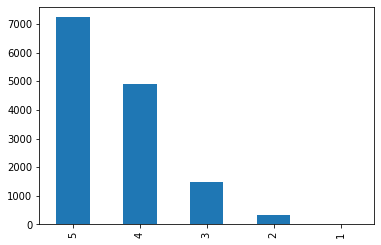

In [ ]:
action['folds_pocket'].value_counts().plot.bar()

The above plot reveals how common it is for 5 out of 6 players to fold their hands before the flop.

# Creating the Long-Joined Data Frame


In [ ]:
# creating long format of summary table
summary_long = pd.melt(summary, id_vars=['id', 'pot', 'board', 'end_stage'], value_vars=['sb', 'bb', 'utg', 'p4', 'p5', 'd'],
                     var_name = 'position', value_name = 'result')
summary_long['win'] = summary_long['result'].map({
    'Won': 1,
})
summary_long['win'] = summary_long['win'].map({
    1.0: 1,
    np.nan: 0
})
start_stacks_long = pd.melt(start, id_vars=['id', 'table'],
                            value_vars=['sb_stack', 'bb_stack', 'utg_stack', 'p4_stack', 'p5_stack', 'd_stack'],
                            var_name = 'position', value_name = 'stack')
start_names_long = pd.melt(start, id_vars=['id', 'table'], value_vars=['sb', 'bb', 'utg', 'p4', 'p5', 'd'],
                           var_name = 'position', value_name = 'name')
poker_long = pd.concat([summary_long, start_stacks_long, start_names_long], axis = 1).iloc[:, [0, 8, 14, 4, 10, 1, 2, 3, 5, 6]]

# creating long format of action table
action_wide = pd.concat([summary.iloc[:, [0, 3, 4, 5, 6, 7, 8]], action.iloc[:, 1:5]], axis = 1)
action_long = pd.melt(action_wide, id_vars=['id', 'pocket', 'flop', 'turn', 'river'], value_vars=['sb', 'bb', 'utg', 'p4', 'p5', 'd'],
                     var_name = 'position', value_name = 'win')
action_long = action_long.iloc[:, 0:5]

In [ ]:
# moving information from action long table outside of lists into their own columns
action_clean_long = pd.DataFrame(columns=['id', 'pocket_fold', 'pocket_check', 'pocket_call', 'pocket_call_amount',
                                          'pocket_bet', 'pocket_bet_amount', 'pocket_raise', 'pocket_raise_amount',
                                          'flop_fold', 'flop_check', 'flop_call', 'flop_call_amount', 
                                          'flop_bet', 'flop_bet_amount', 'flop_raise', 'flop_raise_amount',
                                          'turn_fold', 'turn_check', 'turn_call', 'turn_call_amount', 
                                          'turn_bet', 'turn_bet_amount', 'turn_raise', 'turn_raise_amount',
                                          'river_fold', 'river_check', 'river_call', 'river_call_amount', 
                                          'river_bet', 'river_bet_amount', 'river_raise', 'river_raise_amount',
                                          'all_in', 'return_amount'])

for i in range(len(poker_long)):
  pocket_fold, pocket_check, pocket_call, pocket_call_amount = 0, 0, 0, 0
  pocket_bet, pocket_bet_amount, pocket_raise, pocket_raise_amount = 0, 0, 0, 0
  all_in, return_amount = 0, 0
  for val in action_long['pocket'][i]:
    if poker_long['name'][i] in val:
      if 'Folds' in val:
        pocket_fold += 1
      elif 'Checks' in val:
        pocket_check += 1
      elif 'Calls' in val:
        pocket_call += 1
        pocket_call_amount += float(re.sub('[^\\d.]', '', val[22:]))
      elif 'Bet' in val:
        pocket_bet += 1
        pocket_bet_amount += float(re.sub('[^\\d.]', '', val[22:]))
        if 'All-In' in val:
          all_in += 1
      elif 'Raise' in val:
        pocket_raise += 1
        vals = val.split(' to ')
        pocket_raise_amount += float(re.sub('[^\\d.]', '', vals[0][22:]))
        if 'All-In' in val:
          all_in += 1
      elif 'All-In ' in val:
        all_in += 1
        pocket_call_amount += float(re.sub('[^\\d.]', '', val[22:]))
      elif 'returned' in val:
        return_amount += float(re.sub('[^\\d.]', '', val[22:]))

  flop_fold, flop_check, flop_call, flop_call_amount = 0, 0, 0, 0
  flop_bet, flop_bet_amount, flop_raise, flop_raise_amount = 0, 0, 0, 0
  for val in action_long['flop'][i]:
    if poker_long['name'][i] in val:
      if 'Folds' in val:
        flop_fold += 1
      elif 'Checks' in val:
        flop_check += 1
      elif 'Calls' in val:
        flop_call += 1
        flop_call_amount += float(re.sub('[^\\d.]', '', val[22:]))
      elif 'Bet' in val:
        flop_bet += 1
        flop_bet_amount += float(re.sub('[^\\d.]', '', val[22:]))
        if 'All-In' in val:
          all_in += 1
      elif 'Raise' in val:
        flop_raise += 1
        vals = val.split(' to ')
        flop_raise_amount += float(re.sub('[^\\d.]', '', vals[0][22:]))
        if 'All-In' in val:
          all_in += 1
      elif 'All-In ' in val:
        all_in += 1
        flop_call_amount += float(re.sub('[^\\d.]', '', val[22:]))
      elif 'returned' in val:
        return_amount += float(re.sub('[^\\d.]', '', val[22:]))

  turn_fold, turn_check, turn_call, turn_call_amount = 0, 0, 0, 0
  turn_bet, turn_bet_amount, turn_raise, turn_raise_amount = 0, 0, 0, 0
  for val in action_long['turn'][i]:
    if poker_long['name'][i] in val:
      if 'Folds' in val:
        turn_fold += 1
      elif 'Checks' in val:
        turn_check += 1
      elif 'Calls' in val:
        turn_call += 1
        turn_call_amount += float(re.sub('[^\\d.]', '', val[22:]))
      elif 'Bet' in val:
        turn_bet += 1
        turn_bet_amount += float(re.sub('[^\\d.]', '', val[22:]))
        if 'All-In' in val:
          all_in += 1
      elif 'Raises' in val:
        turn_raise += 1
        vals = val.split(' to ')
        turn_raise_amount += float(re.sub('[^\\d.]', '', vals[0][22:]))
        if 'All-In' in val:
          all_in += 1
      elif 'All-In ' in val:
        all_in += 1
        turn_call_amount += float(re.sub('[^\\d.]', '', val[22:]))
      elif 'returned' in val:
        return_amount += float(re.sub('[^\\d.]', '', val[22:]))

  river_fold, river_check, river_call, river_call_amount = 0, 0, 0, 0
  river_bet, river_bet_amount, river_raise, river_raise_amount = 0, 0, 0, 0
  for val in action_long['river'][i]:
    if poker_long['name'][i] in val:
      if 'Folds' in val:
        river_fold += 1
      elif 'Checks' in val:
        river_check += 1
      elif 'Calls' in val:
        river_call += 1
        river_call_amount += float(re.sub('[^\\d.]', '', val[22:]))
      elif 'Bet' in val:
        river_bet += 1
        river_bet_amount += float(re.sub('[^\\d.]', '', val[22:]))
        if 'All-In' in val:
          all_in += 1
      elif 'Raises' in val:
        river_raise += 1
        vals = val.split(' to ')
        river_raise_amount += float(re.sub('[^\\d.]', '', vals[0][22:]))
        if 'All-In' in val:
          all_in += 1
      elif 'All-In ' in val:
        all_in += 1
        river_call_amount += float(re.sub('[^\\d.]', '', val[22:]))
      elif 'returned' in val:
        return_amount += float(re.sub('[^\\d.]', '', val[22:]))
    
  row = pd.DataFrame([[poker_long['id'][i], pocket_fold, pocket_check, pocket_call, pocket_call_amount, pocket_bet, pocket_bet_amount,
                       pocket_raise, pocket_raise_amount, flop_fold, flop_check, flop_call, flop_call_amount, flop_bet, flop_bet_amount, flop_raise,
                       flop_raise_amount, turn_fold, turn_check, turn_call, turn_call_amount, turn_bet, turn_bet_amount, turn_raise,
                       turn_raise_amount, river_fold, river_check, river_call, river_call_amount, river_bet, river_bet_amount,
                       river_raise, river_raise_amount, all_in, return_amount]],
                     columns=['id', 'pocket_fold', 'pocket_check', 'pocket_call', 'pocket_call_amount', 'pocket_bet',
                              'pocket_bet_amount', 'pocket_raise', 'pocket_raise_amount', 'flop_fold', 'flop_check', 'flop_call',
                              'flop_call_amount', 'flop_bet', 'flop_bet_amount', 'flop_raise', 'flop_raise_amount', 'turn_fold',
                              'turn_check', 'turn_call', 'turn_call_amount', 'turn_bet', 'turn_bet_amount', 'turn_raise',
                              'turn_raise_amount', 'river_fold', 'river_check', 'river_call', 'river_call_amount', 'river_bet',
                              'river_bet_amount', 'river_raise', 'river_raise_amount', 'all_in', 'return_amount'])
  action_clean_long = pd.concat([action_clean_long, row])

action_clean_long = action_clean_long.reset_index(drop=True)

In [ ]:
# calculating the net change in the player's stack for each hand
poker = pd.concat([poker_long, action_clean_long.iloc[:, 1:]], axis = 1)
poker['id'] = poker['id'].astype(int)
poker['net_change'] = 0.0
for i in range(len(poker)):
  if poker['position'][i] == 'sb':
    poker['net_change'][i] -= 5.0

  elif poker['position'][i] == 'bb':
    poker['net_change'][i] -= 10.0
  
  if poker['win'][i] == 1:
    poker['net_change'][i] += poker['pot'][i]

poker['net_change'] += poker['return_amount'] - poker['pocket_call_amount'] - poker['pocket_bet_amount'] - poker['pocket_raise_amount'] - poker['flop_call_amount'] - poker['flop_bet_amount'] - poker['flop_raise_amount'] - poker['turn_call_amount'] - poker['turn_bet_amount'] - poker['turn_raise_amount'] - poker['river_call_amount'] - poker['river_bet_amount'] - poker['river_raise_amount']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


In [ ]:
# exporting data frame to csv for future importing and use
poker.to_csv('poker.csv', index = False)

# Importing Data For Exploration

Since the end of the data cleaning process code takes so long to run, we can skip that part and import the data which is saved in github. Below is the data frame which we are using to explore the data and create our machine learning model. This contains information from 45 different variables, the primary of which are the player's stack size at the start of the hand, their position, amount of money in the pot, the stage at which the game ended, and the net change in the amount of money in the player's stack after the hand is played. 

In [ ]:
poker = pd.read_csv('https://raw.githubusercontent.com/joshblank73/DATA-301/main/poker.csv')

In [ ]:
# shuffling the data for machine learning purposes
poker = poker.sample(frac=1).reset_index(drop = True)

In [ ]:
poker.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83724 entries, 0 to 83723
Data columns (total 45 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   id                   83724 non-null  int64  
 1   table                83724 non-null  object 
 2   name                 83724 non-null  object 
 3   position             83724 non-null  object 
 4   stack                83724 non-null  float64
 5   pot                  83724 non-null  float64
 6   board                39696 non-null  object 
 7   end_stage            83724 non-null  object 
 8   result               83541 non-null  object 
 9   win                  83724 non-null  int64  
 10  pocket_fold          83724 non-null  int64  
 11  pocket_check         83724 non-null  int64  
 12  pocket_call          83724 non-null  int64  
 13  pocket_call_amount   83724 non-null  float64
 14  pocket_bet           83724 non-null  int64  
 15  pocket_bet_amount    83724 non-null 

In [ ]:
poker.head()

,id,table,name,position,stack,pot,board,end_stage,result,win,...,river_check,river_call,river_call_amount,river_bet,river_bet_amount,river_raise,river_raise_amount,all_in,return_amount,net_change
0,3072891638,AZALEA DR,I0oQBKDzn6m6/4XCjS41HA,sb,437.0,20.0,NaN,pocket,Won,1,...,0,0,0.0,0,0.0,0,0.0,0,10.0,10.0
1,3074119764,HOLMBURY RD,yRCsk8TI2PAKL9gB4LG+/A,sb,1990.0,25.0,NaN,pocket,Folded on the POCKET CARDS,0,...,0,0,0.0,0,0.0,0,0.0,0,0.0,-5.0
2,3061456314,BERMUDA HWY,L0wLeZT12m+73aQa8rsMLw,p4,2198.0,60.0,5d 7h 7d,flop,Folded on the POCKET CARDS,0,...,0,0,0.0,0,0.0,0,0.0,0,0.0,0.0
3,3051768410,CLOVER LN,ttncKWaHPEAv9S8VmfX+Qg,p5,676.0,70.0,10h Kd 9h,flop,Folded on the POCKET CARDS,0,...,0,0,0.0,0,0.0,0,0.0,0,0.0,0.0
4,3026081446,AERO AVE,jzhKcsjzeM8Zaw5lPEYSig,p5,4359.0,90.0,Jd 2c 4h,flop,Folded on the POCKET CARDS,0,...,0,0,0.0,0,0.0,0,0.0,0,0.0,0.0


# **Analysis**

Overall, we were interested in analyzing the effect that variables not related to the cards had on the amount of money that a given player earned or lost (net change) during a given hand. First, we were specifically interested in the effect of raising the amount of money in the pot after the pocket cards are dealth and before the flop occurs. We also created a model to predict the net change in the amount of money in a players stack after a given hand based on several variables including their original stack size, their position, the pot size, etc.

# Analyzing the effectivenss of preflop raise sizing

In [ ]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [ ]:
def raise_size(c):
  if c == 0:
    return 'none'
  elif c < 35:
    return 'small'
  elif 35 <= c < 100:
    return 'large'
  else:
    return 'very large'
poker['pocket_raise_size'] = poker['pocket_raise_amount'].map(raise_size)

In [ ]:
poker.groupby(['pocket_raise_size', 'position'])['net_change'].mean()

pocket_raise_size  position
large              bb           19.354855
                   d             8.353918
                   p4            3.142389
                   p5           15.872374
                   sb           19.654973
                   utg          16.761594
none               bb           -4.096871
                   d             2.034610
                   p4            1.387159
                   p5            0.873800
                   sb           -3.370849
                   utg          -0.220035
small              bb           29.704545
                   d            18.767734
                   p4            9.472912
                   p5           15.614421
                   sb            6.921721
                   utg           6.726987
very large         bb           45.782821
                   d            44.872078
                   p4           47.044583
                   p5           85.980450
                   sb           18.365237
      

In [ ]:
poker.groupby(['pocket_raise_size', 'position'])['net_change'].median()

pocket_raise_size  position
large              bb           35.0
                   d            15.0
                   p4           15.0
                   p5           15.0
                   sb           20.0
                   utg          15.0
none               bb          -10.0
                   d             0.0
                   p4            0.0
                   p5            0.0
                   sb           -5.0
                   utg           0.0
small              bb           30.0
                   d            15.0
                   p4           15.0
                   p5           15.0
                   sb           10.0
                   utg          15.0
very large         bb           40.0
                   d            50.0
                   p4           50.0
                   p5           50.0
                   sb           45.0
                   utg         150.0
Name: net_change, dtype: float64

According to the median net chnage in stack size grouped by pocket raise size and position, it can be seen that the most money will be earned when making a very large raise (\$100+) while under the gun (first to act in the pocket). This makes sense since players usually do not raise a lot of money ahead of so many players unless they have a really good hand that is likely to win. This trend can continue to be seen as very large raises in general tend to result in decent increases in ones stack, no matter the position. When looking at small (<\$35) and large (between \$35 and \$100) raises, they tend to be most profitable when played at the big blind.

In [ ]:
chart = alt.Chart(poker.iloc[:20000]).mark_boxplot(ticks=True, outliers=False).encode(
    x=alt.X('pocket_raise_size:O', sort=['none', 'small', 'large', 'very large'], title=None,
            axis=alt.Axis(labels=False, ticks=False), scale=alt.Scale(padding=1)),
    y=alt.Y('net_change:Q'), 
    color='pocket_raise_size:N',
    column=alt.Column('position:N', sort=['sb','bb','utg','p4','p5','d'], header=alt.Header(orient='bottom'))
).properties(
    width=100
).configure_facet(
    spacing=0
).configure_view(
    stroke=None
)
chart

alt.Chart(...)

The figure above shows differences in variation in the net change of ones stack size between the different raise amounts. Despite these differences in variation, we can still gather a lot of information from the image. Frist, it can be seen that very large raises at the dealer and small blind are the most risky, as they can potentially net the most amount of money, but they could also net the largest loss. It is interesting to see how different the results are between a large and very large raise when under the gun. 

# Building a model to predict net change in player stack amount

The models below attempt to predict the net change in the amount of money in a player's stack based on the player's position, their stack size, the pot size, the stage at which the game ends, and the different moves that they make throughout the game.

In [ ]:
X_train = poker[['position', 'stack', 'pot', 'end_stage', 'pocket_fold', 'pocket_check', 'pocket_call',
                 'pocket_call_amount', 'pocket_bet', 'pocket_bet_amount', 'pocket_raise', 'pocket_raise_amount',
                 'flop_fold', 'flop_check', 'flop_call', 'flop_call_amount', 'flop_bet', 'flop_bet_amount', 'flop_raise',
                 'flop_raise_amount', 'turn_fold', 'turn_check', 'turn_call', 'turn_call_amount', 'turn_bet', 'turn_bet_amount',
                 'turn_raise', 'turn_raise_amount', 'river_fold', 'river_check', 'river_call', 'river_call_amount', 'river_bet',
                 'river_bet_amount', 'river_raise', 'river_raise_amount', 'all_in']]
y_train = poker['net_change']

In [ ]:
# Linear Regression Model
ct_new = make_column_transformer(
    (OneHotEncoder(sparse=False), ['position', 'end_stage']),
    remainder='passthrough'
)

linear_model = make_pipeline(
    ct_new,
    StandardScaler(),
    LinearRegression()
)

linear_model.fit(X=X_train, y=y_train)

scores = cross_val_score(linear_model, 
                         X=X_train,
                         y=y_train,
                         scoring='neg_mean_squared_error',
                         cv=5)

np.sqrt(-scores).mean()

132.20026538923562

In [ ]:
# K-Nearest Neighbors Regression Model
ct_new = make_column_transformer(
    (OneHotEncoder(sparse=False), ['position', 'end_stage']),
    remainder='passthrough'
)

knnr_model = make_pipeline(
    ct_new,
    StandardScaler(),
    KNeighborsRegressor(n_neighbors=20)
)

knnr_model.fit(X=X_train, y=y_train)

scores = cross_val_score(knnr_model,
                         X=X_train,
                         y=y_train,
                         scoring='neg_mean_squared_error',
                         cv=5)

np.sqrt(-scores).mean()

128.76334388446435

In [ ]:
# Ensemble model combining the 2 above models
ensemble_model = VotingRegressor([
    ("linear", linear_model), 
    ("knn", knnr_model)
])

ensemble_model.fit(X=X_train, y=y_train)

scores = cross_val_score(ensemble_model,
                         X=X_train,
                         y=y_train,
                         scoring='neg_mean_squared_error',
                         cv=5)

np.sqrt(-scores).mean()

129.45103557811794

The K-nearest neighors regressor model has a lower root mean squared error than the linear regression model and the ensemble model that combines the 2 models. A root mean squared error of 129 indicates that the average prediction will typically be within \$129 of the actual change in a player's stack during a given hand. This may seem like a lot, however, given that the big blind is \$10 and that player stack sizes are on avergae higher than \$1,000, this is actually not too bad of a prediction.

In [ ]:
x_test = pd.Series()

<ipython-input-16-d16354232532>:1: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  x_test = pd.Series()


In [ ]:
# predicting net change in stack size from potential values 
x_test['position'] = 'd'
x_test['stack'] = 1000
x_test['pot'] = 10
x_test['end_stage'] = 'river'
x_test['pocket_fold'] = 0
x_test['pocket_check'] = 0
x_test['pocket_call'] = 1
x_test['pocket_call_amount'] = 10
x_test['pocket_bet'] = 0
x_test['pocket_bet_amount'] = 0
x_test['pocket_raise'] = 0
x_test['pocket_raise_amount'] = 0
x_test['flop_fold'] = 0
x_test['flop_check'] = 0
x_test['flop_call'] = 0
x_test['flop_call_amount'] = 0
x_test['flop_bet'] = 1
x_test['flop_bet_amount'] = 30
x_test['flop_raise'] = 0
x_test['flop_raise_amount'] = 0
x_test['turn_fold'] = 0
x_test['turn_check'] = 1
x_test['turn_call'] = 0
x_test['turn_call_amount'] = 0
x_test['turn_bet'] = 0
x_test['turn_bet_amount'] = 0
x_test['turn_raise'] = 0
x_test['turn_raise_amount'] = 0
x_test['river_fold'] = 0
x_test['river_check'] = 0
x_test['river_call'] = 1
x_test['river_call_amount'] = 0
x_test['river_bet'] = 0
x_test['river_bet_amount'] = 0
x_test['river_raise'] = 1
x_test['river_raise_amount'] = 10
x_test['all_in'] = 0

knnr_model.predict(X=pd.DataFrame([x_test]))[0]

15.125

# Building a model to predict whether a player wins a hand

The models below attempt to predict whether or not a player will lose a given game based on the player's stack based on the player's position, their stack size, the pot size, the stage at which the game ends, and the different moves that they make throughout the game. We removed anything predictors related to folding and checking as those automatically give away whether one loses.

In [ ]:
X_train = poker[['position', 'stack', 'pot', 'end_stage', 'pocket_call',
                 'pocket_call_amount', 'pocket_bet', 'pocket_bet_amount', 'pocket_raise', 'pocket_raise_amount',
                 'flop_call', 'flop_call_amount', 'flop_bet', 'flop_bet_amount', 'flop_raise',
                 'flop_raise_amount', 'turn_call', 'turn_call_amount', 'turn_bet', 'turn_bet_amount',
                 'turn_raise', 'turn_raise_amount', 'river_call', 'river_call_amount', 'river_bet',
                 'river_bet_amount', 'river_raise', 'river_raise_amount', 'all_in']]
y_train = poker['win']

In [ ]:
# K-nearest neighbors classifier model
ct_new = make_column_transformer(
    (OneHotEncoder(sparse=False), ['position', 'end_stage']),
    remainder='passthrough'
)

knnc_model = make_pipeline(
    ct_new,
    StandardScaler(),
    KNeighborsClassifier(n_neighbors=20)
)

knnc_model.fit(X=X_train, y=y_train)

y_train_ = knnc_model.predict(X_train)

In [ ]:
# accuracy, precision, and recall scores for predicting whether a player will win a hand
(accuracy_score(y_train, y_train_),
 precision_score(y_train == 1, y_train_ == 1),
 recall_score(y_train == 1, y_train_ == 1))

(0.9659595814820123, 0.890408092082316, 0.9089225948871323)

In [ ]:
# accuracy, precision, and recall scores for predicting whether a player will lose a hand
(accuracy_score(y_train, y_train_),
 precision_score(y_train == 0, y_train_ == 0),
 recall_score(y_train == 0, y_train_ == 0))

(0.9659595814820123, 0.981567683638617, 0.9774543993341083)

Based on the above values, it can be seen that the model is much better at predicting whether someone will lose than whether they will win. This makes sense as most hands end in losses.

In [ ]:
# predicting net change in stack size from potential values 
x_test['position'] = 'utg'
x_test['stack'] = 1000
x_test['pot'] = 100
x_test['end_stage'] = 'pocket'
x_test['pocket_call'] = 1
x_test['pocket_call_amount'] = 10
x_test['pocket_bet'] = 0
x_test['pocket_bet_amount'] = 0
x_test['pocket_raise'] = 0
x_test['pocket_raise_amount'] = 0
x_test['flop_call'] = 0
x_test['flop_call_amount'] = 0
x_test['flop_bet'] = 0
x_test['flop_bet_amount'] = 0
x_test['flop_raise'] = 0
x_test['flop_raise_amount'] = 0
x_test['turn_call'] = 0
x_test['turn_call_amount'] = 0
x_test['turn_bet'] = 0
x_test['turn_bet_amount'] = 0
x_test['turn_raise'] = 0
x_test['turn_raise_amount'] = 0
x_test['river_call'] = 1
x_test['river_call_amount'] = 60
x_test['river_bet'] = 0
x_test['river_bet_amount'] = 0
x_test['river_raise'] = 0
x_test['river_raise_amount'] = 0
x_test['all_in'] = 0

knnc_model.predict(X=pd.DataFrame([x_test]))[0]

0